# **Understanding Time Series Data**

Time series data represents a sequence of data points collected or recorded at successive time intervals.
    - Each data point is associated with a specific timestamp, indicating the exact moment of data collection or recording.
    - The sequential order and timing of each data point are crucial for analysis and interpretation, distinguishing time series data from other types.
  
- **Applications of Time Series Data**

- **Sales Forecasting**

    - Businesses use time series analysis to predict future sales based on historical sales data.
    - Helps in planning inventory, managing resources, and setting realistic revenue targets.

- **Financial Market Analysis**

    - Crucial for analyzing stock prices, market trends, and financial indicators.
    - Enables traders and investors to make informed decisions by identifying potential investment opportunities and risks.

- **Budgeting and Financial Planning**

    - Organizations leverage time series analysis for budgeting and financial planning.
    - Allows forecasting revenues, expenses, and cash flows, essential for strategic planning and capital allocation.

- **Demand Planning**

    - Time series analysis aids in understanding consumer demand patterns.
    - Vital for inventory management, production planning, and supply chain optimization, reducing stockouts and minimizing excess inventory.

### What is Time Series Decomposition?
Time series decomposition involves breaking down observed data into three key components:

- **Trend**: This reflects the long-term progression of the data, showing movements to higher or lower values over a lengthy period. It captures the underlying growth or decline in the dataset.

- **Seasonality**: These are the cyclical patterns that occur on a regular basis over a specific period, such as daily, weekly, monthly, or yearly seasons. Seasonality helps to identify patterns that repeat at known intervals.

- **Residuals (or Noise)**: These are the irregular fluctuations that cannot be attributed to the trend or seasonal factors. Residuals are essentially the randomness that is left over in the data after accounting for the model and seasonal effects.

### Why Visualize Time Series Decomposition?
Visualizing the components of time series decomposition is crucial for several reasons:

- **Clarity**: It helps in clearly seeing the underlying patterns that can be obfuscated when all components are combined.

- **Analysis**: It allows analysts to understand the behavior of the time series data, facilitating more accurate forecasting and insights.

- **Communication**: Visuals can effectively communicate the findings to stakeholders or team members who may not be as comfortable with raw data or statistical outputs.

### Tools for Time Series Decomposition Visualization
In Python, one of the primary tools for time series decomposition visualization is the `seasonal_decompose` function from the `statsmodels` library. It provides a straightforward method to decompose a time series and plot its components.


### Time Series Decomposition Importance in BI

- **Informed Decision-Making**: BI thrives on data-driven decisions. Time series decomposition can reveal underlying trends and seasonal patterns that are critical for strategic planning, budgeting, and forecasting.

- **Performance Analysis**: By visualizing the trend component, businesses can assess performance over time, stripping away seasonal effects and random noise to see if the long-term trajectory meets strategic goals.

- **Seasonal Adjustment**: Seasonality can obscure the real performance and trends of a business. Understanding seasonal patterns enables businesses to make seasonal adjustments, leading to better performance evaluation and more accurate forecasting.

- **Anomaly Detection**: Decomposition can help in identifying outliers or anomalies that do not fit the typical pattern. This is important for detecting unusual events or issues that require attention.

- **Resource Allocation**: By understanding peak times and seasons, businesses can optimize resource allocation, ensuring that staffing, inventory, and other resources align with demand.

- **Product and Service Improvement**: Insights into time series data can guide product development and service enhancements by identifying when and how customer behavior changes.

- **Market Understanding**: Decomposition helps to clarify how external factors such as holidays, economic cycles, or weather patterns affect business operations and outcomes.

- **Reporting**: BI reporting benefits from clear visuals and decomposed time series data that can explain complex data in an easily digestible format for stakeholders.

- **Data Quality**: It can help in assessing the quality of the data. If the residuals show patterns, this might suggest data collection issues or the need for more complex modeling.






In [1]:
import pandas as pd
import numpy as np

In [6]:
# parse_dates converts the date column to datetime object
df = pd.read_csv('/content/sample_sales_data.csv', index_col='Date', parse_dates=True)
df.head()

,Sales,Expenses,Region,Product,Segment,Country,City,State,Postal_Code,Product_ID,Category,Sub-Category,Product_Name,Quantity,Discount,Profit
Date,,,,,,,,,,,,,,,,
2020-01-01,122.000000,252.000000,West,Product A,Consumer,United States,Houston,California,15544,P-00001,Office Supplies,Appliances,Product C1,8,0.012724,-131.552276
2020-01-02,456.721336,39.993625,East,Product A,Corporate,United States,Houston,New York,23275,P-00002,Furniture,Phones,Product A1,1,0.321245,270.008271
2020-01-03,390.014269,48.984382,East,Product C,Home Office,United States,Phoenix,New York,73248,P-00003,Technology,Appliances,Product D1,9,0.446016,167.077440
2020-01-04,295.161967,237.886215,East,Product C,Home Office,United States,Los Angeles,New York,44550,P-00004,Furniture,Chairs,Product A1,1,0.441908,-73.158757
2020-01-05,132.880243,44.971315,East,Product B,Home Office,United States,Los Angeles,Arizona,63693,P-00005,Office Supplies,Bookcases,Product B1,3,0.349215,41.505176


In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1256 entries, 2020-01-01 to 2023-06-09
Data columns (total 16 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Sales         1256 non-null   float64
 1   Expenses      1256 non-null   float64
 2   Region        1256 non-null   object 
 3   Product       1256 non-null   object 
 4   Segment       1256 non-null   object 
 5   Country       1256 non-null   object 
 6   City          1256 non-null   object 
 7   State         1256 non-null   object 
 8   Postal_Code   1256 non-null   int64  
 9   Product_ID    1256 non-null   object 
 10  Category      1256 non-null   object 
 11  Sub-Category  1256 non-null   object 
 12  Product_Name  1256 non-null   object 
 13  Quantity      1256 non-null   int64  
 14  Discount      1256 non-null   float64
 15  Profit        1256 non-null   float64
dtypes: float64(4), int64(2), object(10)
memory usage: 166.8+ KB


**Line Plots:** Ideal for visualizing data trends over time.


Text(0, 0.5, 'Sales')

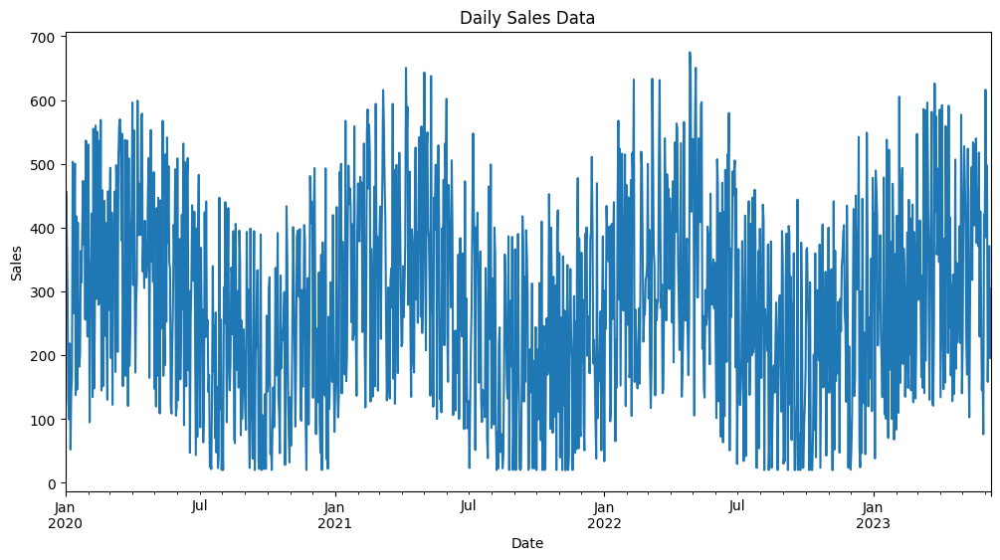

In [8]:
import matplotlib.pyplot as plt
plt.figure(figsize=(12,6))

# Plot daily sales
df['Sales'].plot(title='Daily Sales Data')
plt.ylabel('Sales')

This plot provides an immediate visual representation of the sales on a day-to-day basis. You'll notice the inherent variability in daily sales, which is typical for real-world data.

## Resampling in Pandas: A Powerful Tool for Time Series Data Manipulation

The **`resample`** method in Pandas is a powerful tool for time series data manipulation, allowing you to change the frequency of your time series data. This method is particularly useful for aggregating data by a specified time period, such as converting daily data into monthly or quarterly data, or even downsampling or upsampling data to a finer or coarser granularity.

### How **`resample`** Works

`resample` operates on Pandas Series or DataFrame objects that have a datetime-like index. It groups data into regular time intervals (e.g., daily, monthly, quarterly) and allows you to apply aggregation functions (such as sum, mean, or count) to each group to summarize the data.

### Understanding the **`rule`** Parameter in Pandas Resampling

The `rule` parameter is one of the most important parameters in the `resample` method in Pandas, as it specifies the frequency conversion you want to apply. It takes a string alias representing the target frequency, such as **'D'** for day, **'ME'** for month end, **'QE'** for quarter end, etc. This parameter tells Pandas how to group the data for resampling.

### Simple Example

Imagine you have daily sales data for a month and you want to find out the total sales for each week. Here's a simplified example:

In [9]:
dates = pd.date_range(start="2024-01-01", end="2024-03-31")
data = {
    'Sales': [
        50, 60, 40, 90, 30, 80, 70, 60, 50, 40, 90, 80, 30, 20, 60, 70, 80, 90, 40, 30, 70, 60, 50, 40, 30, 80, 90, 70, 60, 50, 40,  # January (31 values)
        60, 70, 50, 90, 30, 80, 70, 40, 60, 70, 80, 90, 40, 50, 60, 70, 30, 20, 80, 60, 70, 50, 90, 40, 30, 20, 50, 40, 70            # February (29 values)
        , 80, 50, 60, 40, 90, 70, 80, 30, 50, 40, 60, 70, 20, 30, 80, 90, 70, 60, 50, 40, 30, 70, 60, 90, 40, 50, 80, 30, 20, 50, 60   # March (31 values)
    ]
}


In [10]:
df_ex = pd.DataFrame(data, index=dates)

In [11]:
df_ex.head()

,Sales
2024-01-01,50
2024-01-02,60
2024-01-03,40
2024-01-04,90
2024-01-05,30


In [12]:
# Resampling to weekly data, calculate total sales
weekly_sales = df_ex.resample('W').sum()


In [13]:
weekly_sales

,Sales
2024-01-07,420
2024-01-14,370
2024-01-21,440
2024-01-28,420
2024-02-04,420
2024-02-11,430
2024-02-18,360
2024-02-25,420
2024-03-03,370
2024-03-10,400


In [17]:
# Resample to monthly data and calculate total sales
monthly_sales = df_ex.resample('ME').sum()
print("Monthly Sales:\n", monthly_sales)

Monthly Sales:
             Sales
2024-01-31   1800
2024-02-29   1660
2024-03-31   1740


In [19]:
# Resample to quarterly data and calculate total sales
quarterly_sales = df_ex.resample('QE').sum()
print("Quarterly Sales:\n", quarterly_sales)

Quarterly Sales:
             Sales
2024-03-31   5200


## Resampling for Monthly Trends

Resampling is a powerful technique to downsample or upsample your time series data. In our case, we want to downsample our daily sales data to monthly aggregates to observe broader trends without daily noise. This is done using the `.resample()` method followed by an aggregation function like `.sum()` or `.mean()`.


In [20]:
df.head()

,Sales,Expenses,Region,Product,Segment,Country,City,State,Postal_Code,Product_ID,Category,Sub-Category,Product_Name,Quantity,Discount,Profit
Date,,,,,,,,,,,,,,,,
2020-01-01,122.000000,252.000000,West,Product A,Consumer,United States,Houston,California,15544,P-00001,Office Supplies,Appliances,Product C1,8,0.012724,-131.552276
2020-01-02,456.721336,39.993625,East,Product A,Corporate,United States,Houston,New York,23275,P-00002,Furniture,Phones,Product A1,1,0.321245,270.008271
2020-01-03,390.014269,48.984382,East,Product C,Home Office,United States,Phoenix,New York,73248,P-00003,Technology,Appliances,Product D1,9,0.446016,167.077440
2020-01-04,295.161967,237.886215,East,Product C,Home Office,United States,Los Angeles,New York,44550,P-00004,Furniture,Chairs,Product A1,1,0.441908,-73.158757
2020-01-05,132.880243,44.971315,East,Product B,Home Office,United States,Los Angeles,Arizona,63693,P-00005,Office Supplies,Bookcases,Product B1,3,0.349215,41.505176


In [27]:
monthly_sales = df['Sales'].resample('ME').sum()

Text(0, 0.5, 'Total Sales')

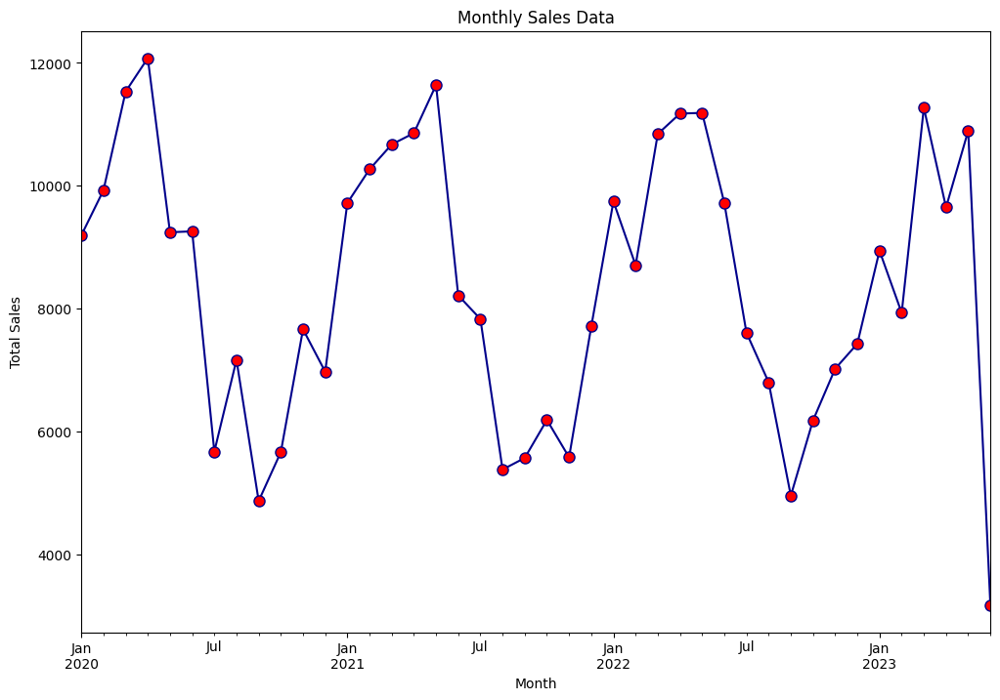

In [28]:
plt.figure(figsize=(12,8))

monthly_sales.plot(marker='o', linestyle='-', color='darkblue', markerfacecolor='red', markersize=8)

plt.title('Monthly Sales Data')
plt.xlabel('Month')
plt.ylabel('Total Sales')

# Aggregating Data by Quarter

To understand sales trends from an even broader perspective, we aggregate our data by quarter. This can help identify overarching trends and reduce the impact of short-term fluctuations or seasonality.


Text(0, 0.5, 'Total Sales')

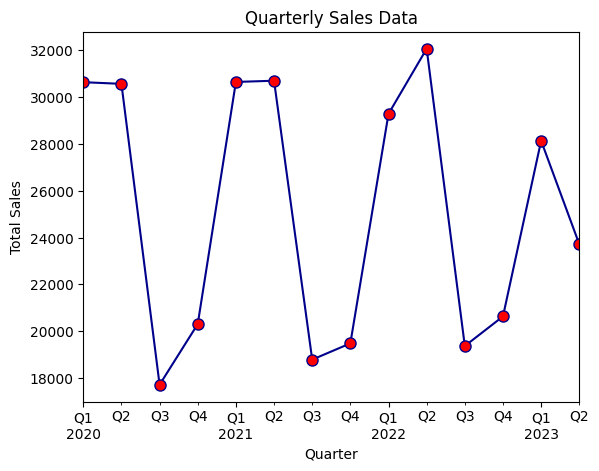

In [34]:
quarterly_sales = df['Sales'].resample('QE').sum()

quarterly_sales.plot(marker='o', linestyle='-', color='darkblue', markerfacecolor='red', markersize=8)

plt.title('Quarterly Sales Data')
plt.xlabel('Quarter')
plt.ylabel('Total Sales')

# Introduction to seasonal_decompose in Python

When analyzing time series data, understanding underlying patterns is crucial. Time series data can contain **trends** (long-term direction), **seasonality** (regular patterns or cycles), and **noise** (random variations). Disentangling these components can be challenging, but the `seasonal_decompose` function in Python's `statsmodels` library offers a straightforward solution.

The `seasonal_decompose` function is designed to separate the time series data into these constituent elements, making it easier to understand and forecast future data points. It does this by using moving averages and filtering techniques to isolate different parts of the time series.

The purpose of `seasonal_decompose` is to:

- **Identify Trend:** Determine if the data shows a long-term upwards or downwards movement over time.
- **Spot Seasonality:** Detect and measure any recurring patterns or cycles that happen within fixed periods.
- **Evaluate Residuals:** Reveal the noise or random variations left in the data after the trend and seasonal components have been extracted.

Understanding these elements can inform better business decisions, improve forecasting models, and help identify anomalies.

## Parameters of seasonal_decompose

When using `seasonal_decompose`, there are several parameters to be aware of:

- **x:** The original time series data. This should be a Pandas Series with a datetime index.
- **model:** Specifies the type of seasonal decomposition to perform. It can be either:
  - `'additive'`: Use this if the seasonal variation is relatively constant over time.
  - `'multiplicative'`: Use this if the seasonal variation increases or decreases proportionally to the time series.
- **period:** The length of the cycle you expect to see in your data. For example, if your time series is monthly data and you expect an annual cycle, the period should be 12.



In [35]:
from statsmodels.tsa.seasonal import seasonal_decompose

In [48]:
result = seasonal_decompose(df['Sales'], model='multiplicative', period=30)

In [38]:
result

In [40]:
result.trend.head(90)

,trend
Date,
2020-01-01,NaN
2020-01-02,NaN
2020-01-03,NaN
2020-01-04,NaN
2020-01-05,NaN
...,...
2020-03-26,368.159636
2020-03-27,366.363014
2020-03-28,366.180076


<function matplotlib.pyplot.tight_layout(*, pad: 'float' = 1.08, h_pad: 'float | None' = None, w_pad: 'float | None' = None, rect: 'tuple[float, float, float, float] | None' = None) -> 'None'>

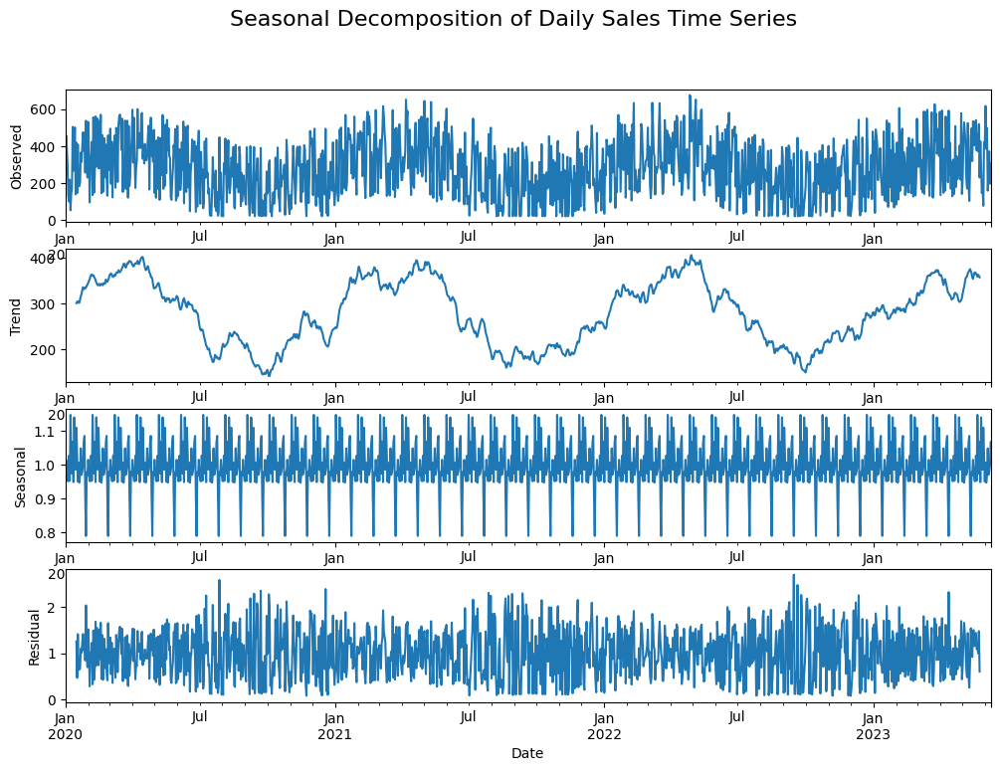

In [53]:
# plot the decomposed components
fig, axes = plt.subplots(ncols=1, nrows=4, figsize=(12, 8))

result.observed.plot(ax=axes[0])
axes[0].set_ylabel('Observed')

result.trend.plot(ax=axes[1])
axes[1].set_ylabel('Trend')

result.seasonal.plot(ax=axes[2])
axes[2].set_ylabel('Seasonal')

result.resid.plot(ax=axes[3])
axes[3].set_ylabel('Residual')

# Add title

plt.suptitle("Seasonal Decomposition of Daily Sales Time Series", fontsize=16)

plt.tight_layout

# Interactive Data Visualization with Plotly
Plotly's Python graphing library makes interactive, publication-quality graphs. Plotly is an open-source and browser-based graphing library which facilitates interactive plotting. Interactive visualizations allow the user to drill down and up through the layers of the details, helping them make the right decisions.

## Plotly & Cufflinks
The Cufflinks library connects the Pandas library with Plotly, which helps you plot interactive visualizations within the Jupyter notebook

In [54]:
import cufflinks as cf
cf.go_offline()
cf.set_config_file(offline=False, world_readable=True)

In [55]:
def enable_plotly_in_cell():
  import IPython
  from plotly.offline import init_notebook_mode
  display(IPython.core.display.HTML('''<script
  src="/static/components/requirejs/require.js"></script>'''))
  init_notebook_mode(connected=False)

## Line Charts
A line chart is a type of chart used to show information that changes over time. Line charts are created by plotting a series of several points. We can easily create a line chart by just calling `iplot()` method on the dataframe and giving which column to use for the x and y-axis.

### Apple Stock Price
Apple OHLC Dataset: It has information about Apple OHLC(Open, High, Low & Close) data from 1984 to 2008. The dataset can be easily downloaded from yahoo finance as CSV.

In [56]:
import yfinance as yf
from pandas_datareader import data as web

In [57]:
apple_df = yf.download("AAPL", start="2017-01-03")

YF.download() has changed argument auto_adjust default to True


[*********************100%***********************]  1 of 1 completed


In [58]:
apple_df.head()

Price,Close,High,Low,Open,Volume
Ticker,AAPL,AAPL,AAPL,AAPL,AAPL
Date,,,,,
2017-01-03,26.862429,26.904058,26.540959,26.781483,115127600
2017-01-04,26.832361,26.945687,26.769918,26.793045,84472400
2017-01-05,26.968811,27.026629,26.783791,26.809232,88774400
2017-01-06,27.269470,27.327289,26.936436,27.008130,127007600
2017-01-09,27.519247,27.621008,27.276411,27.278722,134247600


In [59]:
apple_df.tail()

Price,Close,High,Low,Open,Volume
Ticker,AAPL,AAPL,AAPL,AAPL,AAPL
Date,,,,,
2025-02-27,237.300003,242.460007,237.059998,239.410004,41153600
2025-02-28,241.839996,242.089996,230.199997,236.949997,56833400
2025-03-03,238.029999,244.029999,236.110001,241.789993,47184000
2025-03-04,235.929993,240.070007,234.679993,237.710007,53798100
2025-03-05,235.740005,236.550003,229.229996,235.419998,47200800


In [61]:
enable_plotly_in_cell()

# iplot = interactive plot
apple_df.iplot(y='Open', xTitle='Date', yTitle='Price', title='Open Price from Jan17 to Now')

/usr/local/lib/python3.11/dist-packages/cufflinks/plotlytools.py:117: FutureWarning:

DatetimeIndex.format is deprecated and will be removed in a future version. Convert using index.astype(str) or index.map(formatter) instead.



In [65]:
enable_plotly_in_cell()

# Subplots give each y axis its own visualization graph
apple_df.iplot(y=['Open', 'High', 'Low', 'Close'], subplots=True,
               xTitle='Date', yTitle='Price', title='Open Price from Jan17 to Now')

/usr/local/lib/python3.11/dist-packages/cufflinks/plotlytools.py:117: FutureWarning:

DatetimeIndex.format is deprecated and will be removed in a future version. Convert using index.astype(str) or index.map(formatter) instead.



## Scatter Plot
Scatter plots are mostly used to see relationship between 2 quantitative variable.

In [66]:
import seaborn as sns
tips = sns.load_dataset('tips')

tips.head()

,total_bill,tip,sex,smoker,day,time,size
0,16.99,1.01,Female,No,Sun,Dinner,2
1,10.34,1.66,Male,No,Sun,Dinner,3
2,21.01,3.50,Male,No,Sun,Dinner,3
3,23.68,3.31,Male,No,Sun,Dinner,2
4,24.59,3.61,Female,No,Sun,Dinner,4


In [67]:
tips['tip_rate'] = tips['tip'] / tips['total_bill'] * 100

In [69]:
enable_plotly_in_cell()

tips['tip_rate'].iplot(kind='hist', bins=30, title='Tip Rate Distribution',
                       xTitle='Tip Rate', yTitle='Count')

In [76]:
enable_plotly_in_cell()

tips.iplot(kind='scatter', x='total_bill', y='tip', mode='markers',
           color='blue', bestfit=True, bestfit_colors=['red'],
           xTitle='Total Bill', yTitle='Tip Amount',
           title='Total Bill vs Tip Amount')

## Box Plot
Boxplots are quite handy for quickly interpreting skewness, outliers or quartile ranges in data.

In [80]:
enable_plotly_in_cell()
# Group the data by day, then create a box plot for total_bill

tips[['total_bill', 'day']].pivot(columns='day', values='total_bill').iplot(kind='box',boxpoints='outliers',
                                                                            xTitle='Day of Week',
                                                                            yTitle='Total Bill',
                                                                            title='Total Bill by Day')


In [82]:
!jupyter nbconvert --to html "/content/Series_Decomposition_&_Dynamic_Visualization_start_IanGabrielEusebio.ipynb"

[NbConvertApp] Converting notebook /content/Series_Decomposition_&_Dynamic_Visualization_start_IanGabrielEusebio.ipynb to html
[NbConvertApp] WARNING | Alternative text is missing on 4 image(s).
[NbConvertApp] Writing 24161373 bytes to /content/Series_Decomposition_&_Dynamic_Visualization_start_IanGabrielEusebio.html
